# **Modeling**

In [1]:
import pandas as pd

In [2]:
import os 
os.getcwd()

'/Users/miguelr07116/Documents/MBD/Capgemini/capgemini-group2'

In [5]:
df = pd.read_csv('merged_df.csv')
df.head()

,ReportID,ProductReference,DateOfReport,SupplierName,GarmentType,Material,Weight,ProposedUnitsPerCarton,ProposedFoldingMethod,ProposedLayout,...,Size,Collection,Avg_BadPackagingRate (Sup),Avg_Incidents_PerMonth (Sup),Avg_CostPerIncident_Scorecard (Sup),Avg_OnTimeDeliveryRate (Sup),Avg_Anomalies_PerMonth (Sup),Avg_CostImpact_Product (ProdRef),UnresolvedRate_Product (ProdRef),Total_Incidents_Product (ProdRef)
0,RPT0160152,PRD09822,2024-06-30,Supplierd,Sweater,Cotton,0.83,18.0,Method1,LAYOUTD,...,L,Summer,32.317222,151.111111,534.160000,66.401667,29.277778,511.666667,0.0,3.0
1,RPT0483795,PRD00275,2024-06-30,Suppliera,Dress,Silk,0.35,32.0,Method3,LAYOUTC,...,L,Winter,15.645556,57.537037,558.516296,82.579444,7.259259,354.375000,0.0,2.0
2,RPT0358190,PRD08605,2024-06-30,Supplierc,Dress,Cotton,0.52,17.0,Method1,LAYOUTC,...,L,Summer,24.183889,92.722222,549.542500,72.973333,16.416667,328.500000,0.0,2.0
3,RPT0483823,PRD04922,2024-06-30,Supplierb,Sweater,Silk,0.51,11.0,Method3,LAYOUTB,...,M,Summer,17.606111,91.750000,504.592500,81.120833,14.000000,521.900000,0.2,5.0
4,RPT0047981,PRD03954,2024-06-30,Supplierg,Shirt,Linen,0.19,47.0,Method3,LAYOUTA,...,M,Winter,17.524444,45.055556,587.881667,79.781667,7.833333,272.750000,0.0,4.0


In [4]:
df.shape

(494847, 22)

In [6]:
df.dtypes

ReportID                                object
ProductReference                        object
DateOfReport                            object
SupplierName                            object
GarmentType                             object
Material                                object
Weight                                 float64
ProposedUnitsPerCarton                 float64
ProposedFoldingMethod                   object
ProposedLayout                          object
PackagingQuality                        object
ProductName                             object
Size                                    object
Collection                              object
Avg_BadPackagingRate (Sup)             float64
Avg_Incidents_PerMonth (Sup)           float64
Avg_CostPerIncident_Scorecard (Sup)    float64
Avg_OnTimeDeliveryRate (Sup)           float64
Avg_Anomalies_PerMonth (Sup)           float64
Avg_CostImpact_Product (ProdRef)       float64
UnresolvedRate_Product (ProdRef)       float64
Total_Inciden

## Feature Engineering - Continuos

In [7]:
import pandas as pd

# Ensure date is datetime
df['DateOfReport'] = pd.to_datetime(df['DateOfReport'])

# 1. Estimated package weight = unit weight × proposed units per carton
df['EstimatedPackageWeight'] = df['Weight'] * df['ProposedUnitsPerCarton']

# 2. Product risk score = cost impact × unresolved rate
df['ProductRiskScore'] = df['Avg_CostImpact_Product (ProdRef)'] * df['UnresolvedRate_Product (ProdRef)']

# 3. Supplier risk index = bad packaging rate × avg incidents per month
df['SupplierRiskIndex'] = df['Avg_BadPackagingRate (Sup)'] * df['Avg_Incidents_PerMonth (Sup)']

# 4. Supplier performance ratio = on-time delivery ÷ anomalies
df['SupplierPerformanceRatio'] = df['Avg_OnTimeDeliveryRate (Sup)'] / (df['Avg_Anomalies_PerMonth (Sup)'] + 1e-5)

# 5. Relative incident cost = product cost impact ÷ supplier avg cost
df['RelativeIncidentCost'] = df['Avg_CostImpact_Product (ProdRef)'] / (df['Avg_CostPerIncident_Scorecard (Sup)'] + 1e-5)

# 6. Incidents per unit = historical incidents ÷ proposed units per carton
df['IncidentsPerUnit'] = df['Total_Incidents_Product (ProdRef)'] / (df['ProposedUnitsPerCarton'] + 1e-5)

# 7. Report month (1–12)
df['ReportMonth'] = df['DateOfReport'].dt.month

# 8. Report weekday (0 = Monday)
df['ReportWeekday'] = df['DateOfReport'].dt.weekday

# 9. Report quarter (1–4)
df['ReportQuarter'] = df['DateOfReport'].dt.quarter

# 10. Anomaly-to-incident ratio
df['AnomalyToIncidentRatio'] = df['Avg_Anomalies_PerMonth (Sup)'] / (df['Avg_Incidents_PerMonth (Sup)'] + 1e-5)

# 11. Unresolved impact = unresolved rate × avg cost
df['UnresolvedImpact'] = df['UnresolvedRate_Product (ProdRef)'] * df['Avg_CostImpact_Product (ProdRef)']

# 12. Weight-to-incident ratio 
df['WeightToIncidentRatio'] = df['Weight'] / (df['Total_Incidents_Product (ProdRef)'] + 1e-5)


| Feature Name               | Description                                                                     |
| -------------------------- | ------------------------------------------------------------------------------- |
| `EstimatedPackageWeight`   | Estimated total package weight based on units per carton.                       |
| `ProductRiskScore`         | Combines unresolved rate and cost per incident for the product.                 |
| `SupplierRiskIndex`        | Combines average bad packaging rate and incidents per month.                    |
| `SupplierPerformanceRatio` | On-time delivery rate divided by anomaly detection rate.                        |
| `RelativeIncidentCost`     | Ratio of product incident cost vs supplier average.                             |
| `IncidentsPerUnit`         | Frequency of incidents normalized per unit in carton.                           |
| `ReportMonth`              | Month the report was created (1–12).                                            |
| `ReportWeekday`            | Day of the week the report was logged (0=Mon).                                  |
| `ReportQuarter`            | Quarter of the year the report was created.                                     |
| `AnomalyToIncidentRatio`   | Anomalies per month vs incidents per month for the supplier.                    |
| `UnresolvedImpact`         | Combines unresolved rate with cost impact — severity proxy.                     |
| `WeightToIncidentRatio`    | Ratio of unit weight to number of past incidents — inverse signal of fragility. |


## Feature Engineering Categorical

In [11]:
identifier_cols = ['ReportID', 'ProductReference','ProductName']

categorical_cols = [col for col in df.select_dtypes(include='object').columns if col not in identifier_cols]

unique_values_dict = {col: df[col].unique().tolist() for col in categorical_cols}
unique_values_dict

{'SupplierName': ['Supplierd',
  'Suppliera',
  'Supplierc',
  'Supplierb',
  'Supplierg',
  'Suppliere',
  'Supplierf',
  'Supplierh'],
 'GarmentType': ['Sweater',
  'Dress',
  'Shirt',
  'Jacket',
  'Shorts',
  'T-Shirt',
  'Suit',
  'Pants',
  'Skirt',
  'Hoodie',
  'Coat',
  'Blouse'],
 'Material': ['Cotton', 'Silk', 'Linen', 'Polyester', 'Wool', 'Denim'],
 'ProposedFoldingMethod': ['Method1', 'Method3', 'Method2', 'Foldx'],
 'ProposedLayout': ['LAYOUTD',
  'LAYOUTC',
  'LAYOUTB',
  'LAYOUTA',
  'LAYOUTE',
  'LAYOUT_OTHER'],
 'PackagingQuality': ['Good', 'Bad'],
 'Size': ['L', 'M', 'S', 'XL', 'XS'],
 'Collection': ['Summer', 'Winter', 'Autumn', 'Spring']}

In [18]:
from sklearn.preprocessing import LabelEncoder

# Define categorical columns to encode
categorical_cols = [
    'SupplierName',
    'GarmentType',
    'Material',
    'ProposedFoldingMethod',
    'ProposedLayout',
    'Size',
    'Collection'
]

# Apply LabelEncoder to each column
label_encoders = {}  # store encoders for possible inverse_transform later

for col in categorical_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col].astype(str))
    label_encoders[col] = le  # store the encoder

# Encode the target column: Good → 1, Bad → 0
df['PackagingQuality'] = df['PackagingQuality'].map({'Good': 1, 'Bad': 0})


In [24]:
df.dtypes

ReportID                                       object
ProductReference                               object
DateOfReport                           datetime64[ns]
SupplierName                                    int64
GarmentType                                     int64
Material                                        int64
Weight                                        float64
ProposedUnitsPerCarton                        float64
ProposedFoldingMethod                           int64
ProposedLayout                                  int64
PackagingQuality                                int64
ProductName                                    object
Size                                            int64
Collection                                      int64
Avg_BadPackagingRate (Sup)                    float64
Avg_Incidents_PerMonth (Sup)                  float64
Avg_CostPerIncident_Scorecard (Sup)           float64
Avg_OnTimeDeliveryRate (Sup)                  float64
Avg_Anomalies_PerMonth (Sup)

In [25]:
# Define columns to drop (non-feature, non-numeric, or identifiers)
cols_to_drop = [
    'ReportID',
    'ProductReference',
    'DateOfReport',
    'ProductName'
]

# Create a clean model-ready DataFrame
df_model = df.drop(columns=cols_to_drop).copy()


In [32]:
df_model.isna().mean()

SupplierName                           0.0
GarmentType                            0.0
Material                               0.0
Weight                                 0.0
ProposedUnitsPerCarton                 0.0
ProposedFoldingMethod                  0.0
ProposedLayout                         0.0
PackagingQuality                       0.0
Size                                   0.0
Collection                             0.0
Avg_BadPackagingRate (Sup)             0.0
Avg_Incidents_PerMonth (Sup)           0.0
Avg_CostPerIncident_Scorecard (Sup)    0.0
Avg_OnTimeDeliveryRate (Sup)           0.0
Avg_Anomalies_PerMonth (Sup)           0.0
Avg_CostImpact_Product (ProdRef)       0.0
UnresolvedRate_Product (ProdRef)       0.0
Total_Incidents_Product (ProdRef)      0.0
EstimatedPackageWeight                 0.0
ProductRiskScore                       0.0
SupplierRiskIndex                      0.0
SupplierPerformanceRatio               0.0
RelativeIncidentCost                   0.0
IncidentsPe

## Exploration

In [33]:
import plotly.express as px

# Boxplot para detectar outliers en 'Weight'
fig_weight = px.box(df, y='Weight', title='Outliers en Weight')
fig_weight.show()

# Boxplot para detectar outliers en 'ProposedUnitsPerCarton'
fig_units = px.box(df, y='ProposedUnitsPerCarton', title='Outliers en ProposedUnitsPerCarton')
fig_units.show()

## Imputation Median

In [63]:
import numpy as np

# Copy to preserve original if needed
df_cleaned = df_model.copy()

# Clean invalid outliers 
df_cleaned.loc[df_cleaned['ProposedUnitsPerCarton'] <= 0, 'ProposedUnitsPerCarton'] = np.nan
df_cleaned.loc[df_cleaned['ProposedUnitsPerCarton'] > 200, 'ProposedUnitsPerCarton'] = np.nan

# Impute with median based on GarmentType + Material
df_cleaned['ProposedUnitsPerCarton'] = df_cleaned.groupby(
    ['GarmentType', 'Material']
)['ProposedUnitsPerCarton'].transform(lambda x: x.fillna(x.median()))

In [64]:
df_cleaned.isna().sum()

SupplierName                           0
GarmentType                            0
Material                               0
Weight                                 0
ProposedUnitsPerCarton                 0
ProposedFoldingMethod                  0
ProposedLayout                         0
PackagingQuality                       0
Size                                   0
Collection                             0
Avg_BadPackagingRate (Sup)             0
Avg_Incidents_PerMonth (Sup)           0
Avg_CostPerIncident_Scorecard (Sup)    0
Avg_OnTimeDeliveryRate (Sup)           0
Avg_Anomalies_PerMonth (Sup)           0
Avg_CostImpact_Product (ProdRef)       0
UnresolvedRate_Product (ProdRef)       0
Total_Incidents_Product (ProdRef)      0
EstimatedPackageWeight                 0
ProductRiskScore                       0
SupplierRiskIndex                      0
SupplierPerformanceRatio               0
RelativeIncidentCost                   0
IncidentsPerUnit                       0
ReportMonth     

In [65]:
fig_units = px.box(df_cleaned, y='ProposedUnitsPerCarton', title='Outliers en ProposedUnitsPerCarton')
fig_units.show()

## Modeling

In [66]:
df_cleaned.groupby(['PackagingQuality']).size()

PackagingQuality
0     98253
1    396594
dtype: int64

In [69]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from xgboost import XGBClassifier

# Define features and target
X = df_cleaned.drop(columns=['PackagingQuality'])
y = df_cleaned['PackagingQuality'].astype(int)

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Set up stratified cross-validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Define hyperparameter grid
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [4, 6],
    'learning_rate': [0.05, 0.1],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

# Initialize base XGBoost model
xgb = XGBClassifier(
    random_state=42,
    use_label_encoder=False,
    eval_metric='aucpr', # More appropriate for imbalanced classification
    scale_pos_weight=0.25  # Adjusted based on class imbalance
)

# GridSearchCV to find best hyperparameters
grid_search = GridSearchCV(
    estimator=xgb,
    param_grid=param_grid,
    cv=cv,
    scoring='f1', # Optimizes for both precision and recall
    verbose=1,
    n_jobs=-1
)

# Fit the model on training data
grid_search.fit(X_train, y_train)

# Use the best model to predict on test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
y_proba = best_model.predict_proba(X_test)[:, 1]

# Evaluate the final model
print("Best parameters:", grid_search.best_params_)
print("\nClassification Report:\n", classification_report(y_test, y_pred))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\nROC AUC Score:", roc_auc_score(y_test, y_proba))


Fitting 5 folds for each of 32 candidates, totalling 160 fits


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:26:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:26:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:26:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:26:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

Best parameters: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 200, 'subsample': 0.8}

Classification Report:
               precision    recall  f1-score   support

           0       0.30      0.70      0.42     19651
           1       0.89      0.60      0.71     79319

    accuracy                           0.62     98970
   macro avg       0.59      0.65      0.57     98970
weighted avg       0.77      0.62      0.66     98970


Confusion Matrix:
 [[13708  5943]
 [31982 47337]]

ROC AUC Score: 0.6971279473312666


In [70]:
import plotly.express as px
import pandas as pd

# Step 1: Extract feature importances using 'gain'
booster = best_model.get_booster()
importance_dict = booster.get_score(importance_type='gain')

# Step 2: Convert to DataFrame
importance_df = pd.DataFrame({
    'Feature': list(importance_dict.keys()),
    'Importance': list(importance_dict.values())
})

# Step 3: Sort by importance descending
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Step 4: Plot with Plotly
fig = px.bar(
    importance_df,
    x='Importance',
    y='Feature',
    orientation='h',
    title='XGBoost Feature Importance (by Gain)',
    height=600
)
fig.update_layout(yaxis={'categoryorder': 'total ascending'})
fig.show()


## New Training

In [73]:
# Feature 1: Supplier-Product Interaction Score
# Combines supplier risk and historical product cost to highlight risky supplier-product pairs
df_cleaned['SupplierProductInteractionScore'] = (
    df_cleaned['SupplierRiskIndex'] * df_cleaned['Avg_CostImpact_Product (ProdRef)']
)

# Feature 2: Anomaly Rate per Unit Weight
# Normalizes the anomaly rate by product weight to detect over-sensitive light garments
df_cleaned['AnomalyPerWeightUnit'] = df_cleaned['Avg_Anomalies_PerMonth (Sup)'] / (df_cleaned['Weight'] + 1e-3)

# Feature 3: Incident Density per Carton
# Measures how concentrated the historical incidents are per unit packed
df_cleaned['IncidentDensity'] = df_cleaned['Total_Incidents_Product (ProdRef)'] / (df_cleaned['ProposedUnitsPerCarton'] + 1)


| Feature                           | Type      | Explanation                                                                                                                                             |
| --------------------------------- | --------- | ------------------------------------------------------------------------------------------------------------------------------------------------------- |
| `SupplierProductInteractionScore` | Composite | Highlights potential risk from the combination of a historically costly product and a risky supplier. Useful when neither variable alone is predictive. |
| `AnomalyPerWeightUnit`            | Ratio     | Adjusts anomaly rate by product weight. Helps detect suppliers with poor handling of lightweight garments (more fragile).                               |
| `IncidentDensity`                 | Ratio     | Normalizes historical incidents by units per carton. Captures whether denser packaging leads to more issues.                                            |


In [77]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from xgboost import XGBClassifier

# Define features and target
X = df_cleaned.drop(columns=['PackagingQuality'])
y = df_cleaned['PackagingQuality'].astype(int)

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Set up stratified cross-validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Define hyperparameter grid
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [4, 6],
    'learning_rate': [0.05, 0.1],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

# Initialize base XGBoost model
xgb = XGBClassifier(
    random_state=42,
    use_label_encoder=False,
    eval_metric='aucpr', # More appropriate for imbalanced classification
    scale_pos_weight=0.25  # Adjusted based on class imbalance
)

# GridSearchCV to find best hyperparameters
grid_search = GridSearchCV(
    estimator=xgb,
    param_grid=param_grid,
    cv=cv,
    scoring='f1', # Optimizes for both precision and recall
    verbose=1,
    n_jobs=-1
)

# Fit the model on training data
grid_search.fit(X_train, y_train)

# Use the best model to predict on test set
best_model_2 = grid_search.best_estimator_
y_pred = best_model_2.predict(X_test)
y_proba = best_model_2.predict_proba(X_test)[:, 1]

# Evaluate the final model
print("Best parameters:", grid_search.best_params_)
print("\nClassification Report:\n", classification_report(y_test, y_pred))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\nROC AUC Score:", roc_auc_score(y_test, y_proba))


Fitting 5 folds for each of 32 candidates, totalling 160 fits


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:41:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:41:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:41:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [12:41:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

Best parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 200, 'subsample': 0.8}

Classification Report:
               precision    recall  f1-score   support

           0       0.30      0.70      0.42     19651
           1       0.89      0.59      0.71     79319

    accuracy                           0.62     98970
   macro avg       0.59      0.65      0.57     98970
weighted avg       0.77      0.62      0.65     98970


Confusion Matrix:
 [[13753  5898]
 [32195 47124]]

ROC AUC Score: 0.6961558986587539


In [78]:
import plotly.express as px
import pandas as pd

# Step 1: Extract feature importances using 'gain'
booster = best_model_2.get_booster()
importance_dict = booster.get_score(importance_type='gain')

# Step 2: Convert to DataFrame
importance_df = pd.DataFrame({
    'Feature': list(importance_dict.keys()),
    'Importance': list(importance_dict.values())
})

# Step 3: Sort by importance descending
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Step 4: Plot with Plotly
fig = px.bar(
    importance_df,
    x='Importance',
    y='Feature',
    orientation='h',
    title='XGBoost Feature Importance (by Gain)',
    height=600
)
fig.update_layout(yaxis={'categoryorder': 'total ascending'})
fig.show()


In [121]:
import numpy as np
from sklearn.metrics import f1_score, precision_score, recall_score, roc_auc_score

# Get predicted probabilities for the positive class
y_probs = best_model_2.predict_proba(X_test)[:, 1]

# Define thresholds to test
thresholds = np.arange(0.1, 0.9, 0.01)

# Store metrics for each threshold
results = []

for thresh in thresholds:
    y_pred_thresh = (y_probs >= thresh).astype(int)
    
    f1 = f1_score(y_test, y_pred_thresh)
    precision = precision_score(y_test, y_pred_thresh)
    recall = recall_score(y_test, y_pred_thresh)
    results.append((thresh, f1, precision, recall))

# Convert to DataFrame
import pandas as pd
results_df = pd.DataFrame(results, columns=['Threshold', 'F1', 'Precision', 'Recall'])

# Plot
import plotly.express as px
fig = px.line(results_df, x='Threshold', y=['F1', 'Precision', 'Recall'], 
              title='Threshold vs. F1 / Precision / Recall')
fig.show()


In [119]:
chosen_thresh = 0.40

# Apply threshold
y_pred_custom = (y_probs >= chosen_thresh).astype(int)

# Evaluate
print("Classification Report:\n")
print(classification_report(y_test, y_pred_custom))
print("Confusion Matrix:\n")
print(confusion_matrix(y_test, y_pred_custom))


Classification Report:

              precision    recall  f1-score   support

           0       0.34      0.46      0.39     19651
           1       0.85      0.78      0.82     79319

    accuracy                           0.72     98970
   macro avg       0.60      0.62      0.61     98970
weighted avg       0.75      0.72      0.73     98970

Confusion Matrix:

[[ 9059 10592]
 [17270 62049]]


## SMOTE

In [91]:
!pip install imbalanced-learn


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [92]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

# Apply SMOTE to balance the training set
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Check new class distribution
import pandas as pd
print("Class distribution after SMOTE:\n", pd.Series(y_train_smote).value_counts())


/opt/anaconda3/lib/python3.12/site-packages/sklearn/base.py:474: FutureWarning:

`BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.



Class distribution after SMOTE:
 PackagingQuality
1    317275
0    317275
Name: count, dtype: int64


In [100]:
y_train.value_counts()

PackagingQuality
1    317275
0     78602
Name: count, dtype: int64

In [101]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV

# Define new parameter grid (no scale_pos_weight)
param_grid_smote = {
    'n_estimators': [100, 200],
    'max_depth': [4, 6, 8],
    'learning_rate': [0.05, 0.1],
    'subsample': [0.8],
    'colsample_bytree': [0.8]
}

# Initialize model without scale_pos_weight
xgb_smote = XGBClassifier(
    random_state=42,
    use_label_encoder=False,
    eval_metric='logloss'
)

# Grid Search using same CV as before, but balanced data
grid_search_smote = GridSearchCV(
    estimator=xgb_smote,
    param_grid=param_grid_smote,
    scoring='f1_macro',
    cv=cv,               # reuse your existing cross-validator
    n_jobs=-1,
    verbose=2
)

# Fit on the SMOTE-balanced training data
grid_search_smote.fit(X_train_smote, y_train_smote)

# Store the best model
best_model_smote = grid_search_smote.best_estimator_

# Print best params and score
print("Best Params:", grid_search_smote.best_params_)
print("Best F1-macro:", grid_search_smote.best_score_)


Fitting 5 folds for each of 12 candidates, totalling 60 fits


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8; total time=   5.8s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8; total time=   5.9s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8; total time=   5.9s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8; total time=   5.9s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8; total time=   6.1s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8; total time=   9.6s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8; total time=   9.7s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8; total time=  10.1s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=100, subsample=0.8; total time=   7.9s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=100, subsample=0.8; total time=   7.8s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.2s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:29] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:30] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:30] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8; total time=  10.8s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8; total time=  10.8s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.2s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:32] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:32] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.6s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:39] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.9s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.6s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.5s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.8s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.8s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:42] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:42] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.4s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:45] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.9s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:49] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.7s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8; total time=   6.4s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:52] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:52] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8; total time=   6.5s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:56] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8; total time=   6.4s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8; total time=   6.7s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=200, subsample=0.8; total time=  17.1s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=200, subsample=0.8; total time=  16.9s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=200, subsample=0.8; total time=  17.1s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:58] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:02:58] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=200, subsample=0.8; total time=  17.4s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=8, n_estimators=200, subsample=0.8; total time=  17.4s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8; total time=   7.2s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:03] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8; total time=  11.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8; total time=  11.3s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8; total time=  10.8s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8; total time=  11.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.4s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8; total time=  11.0s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:10] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:11] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:11] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packa

[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   7.9s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, subsample=0.8; total time=   8.3s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:16] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:17] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.8s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.6s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.7s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.7s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.6s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=200, subsample=0.8; total time=  13.5s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:24] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.7s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:24] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.9s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [13:03:26] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.6s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, subsample=0.8; total time=   9.3s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=200, subsample=0.8; total time=  14.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=200, subsample=0.8; total time=  13.7s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=200, subsample=0.8; total time=  13.7s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=200, subsample=0.8; total time=  13.6s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=8, n_estimators=200, subsample=0.8; total time=  12.8s


/opt/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning:

[13:03:38] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




Best Params: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 8, 'n_estimators': 200, 'subsample': 0.8}
Best F1-macro: 0.8420266690616458


In [103]:
# Predict probabilities
y_probs_smote = best_model_smote.predict_proba(X_test)[:, 1]

# Default prediction with threshold = 0.5
y_pred_05 = (y_probs_smote >= 0.5).astype(int)

# Evaluation metrics
print("Classification Report (Threshold = 0.5):\n")
print(classification_report(y_test, y_pred_05))

print("\nConfusion Matrix (Threshold = 0.5):")
print(confusion_matrix(y_test, y_pred_05))


Classification Report (Threshold = 0.5):

              precision    recall  f1-score   support

           0       0.37      0.13      0.19     19651
           1       0.81      0.95      0.87     79319

    accuracy                           0.78     98970
   macro avg       0.59      0.54      0.53     98970
weighted avg       0.72      0.78      0.74     98970


Confusion Matrix (Threshold = 0.5):
[[ 2485 17166]
 [ 4311 75008]]


In [106]:
import numpy as np
import pandas as pd
import plotly.express as px
from sklearn.metrics import f1_score, precision_score, recall_score

# Search across threshold range
thresholds = np.arange(0.1, 0.9, 0.01)
results = []

for thresh in thresholds:
    preds = (y_probs_smote >= thresh).astype(int)
    f1 = f1_score(y_test, preds)
    prec = precision_score(y_test, preds)
    rec = recall_score(y_test, preds)
    results.append((thresh, f1, prec, rec))

# Save results
results_df = pd.DataFrame(results, columns=["Threshold", "F1", "Precision", "Recall"])

# Plot
fig = px.line(results_df, x='Threshold', y=['F1', 'Precision', 'Recall'],
              title="SMOTE Model - Threshold Optimization")
fig.show()



In [114]:
threshold = 0.65

# Predict using threshold
y_pred_best_thresh = (y_probs_smote >= threshold).astype(int)

# Final performance
print("\n Classification Report (Best Threshold):\n")
print(classification_report(y_test, y_pred_best_thresh))

print("\n Confusion Matrix (Best Threshold):")
print(confusion_matrix(y_test, y_pred_best_thresh))



 Classification Report (Best Threshold):

              precision    recall  f1-score   support

           0       0.32      0.45      0.38     19651
           1       0.85      0.77      0.81     79319

    accuracy                           0.70     98970
   macro avg       0.59      0.61      0.59     98970
weighted avg       0.75      0.70      0.72     98970


 Confusion Matrix (Best Threshold):
[[ 8843 10808]
 [18419 60900]]


## Best Model Generalization (Model_2)

Classification Report (Balanced Test Set):

              precision    recall  f1-score   support

           0       0.63      0.70      0.67     19651
           1       0.66      0.60      0.63     19651

    accuracy                           0.65     39302
   macro avg       0.65      0.65      0.65     39302
weighted avg       0.65      0.65      0.65     39302



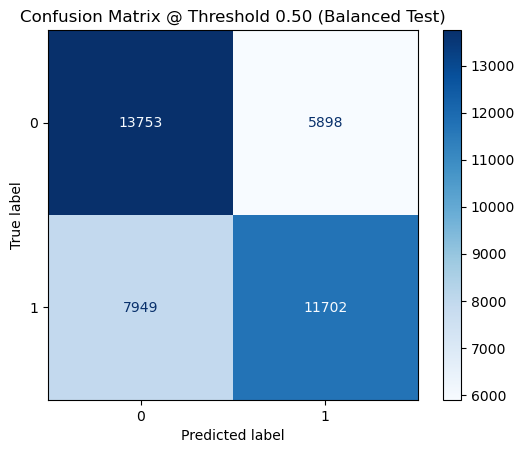

In [152]:
from sklearn.utils import resample
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Combine test features and target
test_df = X_test.copy()
test_df['target'] = y_test.values

# Separate by class
class_0 = test_df[test_df['target'] == 0]
class_1 = test_df[test_df['target'] == 1]

# Downsample majority class (class 1) to match class 0
class_1_downsampled = resample(class_1, 
                               replace=False, 
                               n_samples=len(class_0), 
                               random_state=42)

# Concatenate to form balanced test set
balanced_test = pd.concat([class_0, class_1_downsampled])
X_test_bal = balanced_test.drop(columns='target')
y_test_bal = balanced_test['target']

# Predict probabilities and apply threshold
threshold = 0.50
y_probs_bal = best_model_2.predict_proba(X_test_bal)[:, 1]
y_pred_bal = (y_probs_bal >= threshold).astype(int)

# Evaluation metrics
print("Classification Report (Balanced Test Set):\n")
print(classification_report(y_test_bal, y_pred_bal))

# Confusion Matrix
cm = confusion_matrix(y_test_bal, y_pred_bal)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_model_2.classes_)
disp.plot(cmap="Blues", values_format="d")
plt.title(f"Confusion Matrix @ Threshold {threshold:.2f} (Balanced Test)")
plt.show()
